In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans
import geopandas as gpd
import folium
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv("/Users/sandeepsrinivasdwaram/Documents/business_failures/business_failures_franceData_2014-2024.csv")

In [5]:
# Load France shapefile/GeoJSON
france_map = gpd.read_file("/Users/sandeepsrinivasdwaram/Documents/business_failures/gadm41_FRA_4.json")
print(france_map.head(10))  # Inspect the geospatial data

           GID_4 GID_0 COUNTRY    GID_1                NAME_1      GID_2  \
0  FRA.1.1.1.1_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
1  FRA.1.1.1.2_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
2  FRA.1.1.1.3_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
3  FRA.1.1.1.4_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
4  FRA.1.1.1.5_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
5  FRA.1.1.1.6_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
6  FRA.1.1.1.7_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
7  FRA.1.1.1.8_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
8  FRA.1.1.1.9_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   
9  FRA.1.1.2.1_1   FRA  France  FRA.1_1  Auvergne-Rhône-Alpes  FRA.1.1_1   

  NAME_2        GID_3           NAME_3                  NAME_4 VARNAME_4  \
0    Ain  FRA.1.1.1_1           Belley       Ambérieu-en-Bugey        NA   
1    Ain  F

In [24]:
# Aggregate failure units by Region
failure_by_region = df.groupby('Region')['FailureUnit'].sum().reset_index()


In [7]:
failure_by_region 

,Region,FailureUnit
0,Auvergne-Rhône-Alpes,123879
1,Bourgogne-Franche-Comté,44232
2,Bretagne,43660
3,Centre-ValdeLoire,33873
4,Corse,7208
5,GrandEst,81294
6,Hauts-de-France,86098
7,Nil,15632
8,Normandie,46232
9,Nouvelle-Aquitaine,96052


In [10]:
france_map['NAME_1'].value_counts()

NAME_1
Nouvelle-Aquitaine           485
Auvergne-Rhône-Alpes         478
Occitanie                    456
GrandEst                     365
Hauts-de-France              302
Bourgogne-Franche-Comté      292
Île-de-France                286
Normandie                    249
Provence-Alpes-Côted'Azur    209
PaysdelaLoire                191
Bretagne                     187
Centre-ValdeLoire            185
Corse                         43
Name: count, dtype: int64

In [11]:
# Merge geospatial data with failure data
geo_failure_data = france_map.merge(failure_by_region, how="left", left_on="NAME_1", right_on="Region")


In [12]:
geo_failure_data

,GID_4,GID_0,COUNTRY,GID_1,NAME_1,GID_2,NAME_2,GID_3,NAME_3,NAME_4,VARNAME_4,TYPE_4,ENGTYPE_4,CC_4,geometry,Region,FailureUnit
0,FRA.1.1.1.1_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Ambérieu-en-Bugey,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.3666 45.9364, 5.338 45.9468,...",Auvergne-Rhône-Alpes,123879
1,FRA.1.1.1.2_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Belley,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.6364 45.6174, 5.6322 45.6115...",Auvergne-Rhône-Alpes,123879
2,FRA.1.1.1.3_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Champagne-en-Valromey,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.7494 45.8355, 5.7412 45.8438...",Auvergne-Rhône-Alpes,123879
3,FRA.1.1.1.4_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Hauteville-Lompnes,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.6129 45.8532, 5.5947 45.8629...",Auvergne-Rhône-Alpes,123879
4,FRA.1.1.1.5_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Lagnieu,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.191 45.7719, 5.1873 45.781, ...",Auvergne-Rhône-Alpes,123879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3723,FRA.13.6.3.5_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Malaucène,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.0739 44.1877, 5.0683 44.19, ...",Provence-Alpes-Côted'Azur,114074
3724,FRA.13.6.3.6_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Mormoiron,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.2374 43.9856, 5.2235 43.9829...",Provence-Alpes-Côted'Azur,114074
3725,FRA.13.6.3.7_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Pernes-les-Fontaines,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.044 43.945, 5.0074 43.9472, ...",Provence-Alpes-Côted'Azur,114074
3726,FRA.13.6.3.8_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Sault,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.5446 44.0699, 5.5429 44.0244...",Provence-Alpes-Côted'Azur,114074


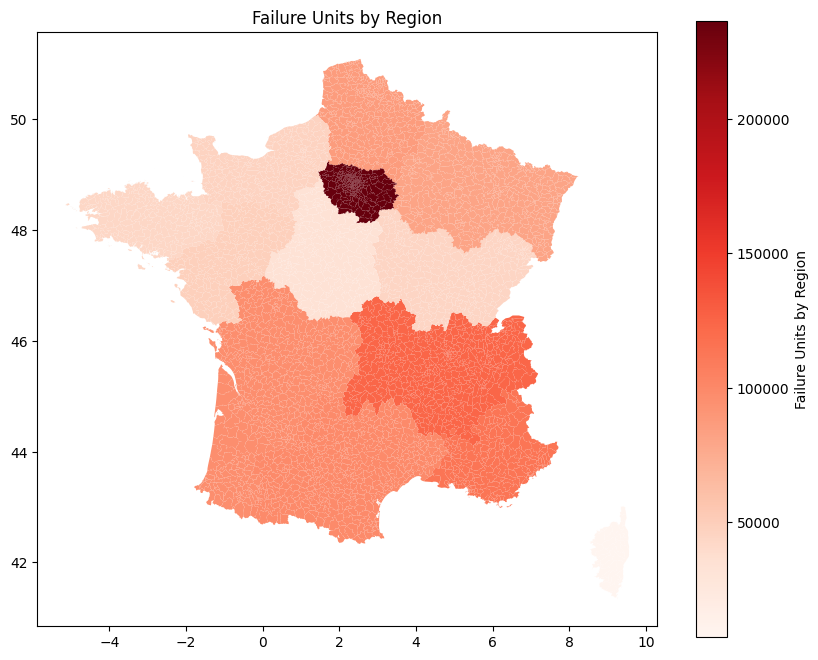

In [13]:
geo_failure_data.plot(column='FailureUnit', cmap='Reds', legend=True, 
                      legend_kwds={'label': "Failure Units by Region"},
                      figsize=(10, 8))
plt.title("Failure Units by Region")
plt.show()

In [15]:
# Create a base map
m = folium.Map(location=[46.603354, 1.888334], zoom_start=6)  # Coordinates of France


In [20]:
m

In [18]:
# Add choropleth layer
folium.Choropleth(
    geo_data=geo_failure_data, 
    name='choropleth',
    data=geo_failure_data,
    columns=['NAME_1', 'FailureUnit'],
    key_on='feature.properties.NAME_1', 
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Failure Units'
).add_to(m)

# Display the map
m.save("failure_units_map.html")

In [19]:
m

In [21]:
france_map['NAME_3'].value_counts()

NAME_3
Grenoble                   35
Lyon                       35
Lille                      25
Albi                       24
Rodez                      24
                           ..
Paris,14earrondissement     1
Paris,12earronissement      1
Paris,12earrondissement     1
Paris,11earrondissement     1
Paris,13earrondissement     1
Name: count, Length: 350, dtype: int64

In [22]:
france_map['NAME_4'].value_counts()

NAME_4
Neuvic               2
Montreuil            2
Villers-Bocage       2
Fontaine             2
Beaufort             2
                    ..
Ramerupt             1
Sainte-Savine        1
Troyes               1
Troyes1erCanton      1
Vaison-la-Romaine    1
Name: count, Length: 3713, dtype: int64

In [28]:
df['Capital'] = df['Capital'].str.strip()

In [29]:
df['Capital'].unique()

array(['Foix', 'Bourges', 'SaintBrieuc', 'Périgueux', 'Besançon',
       'Valence', 'Auch', 'Bastia', 'Tarbes', 'Nanterre', 'Rennes',
       'Tours', 'LonsleSaunier', 'MontdeMarsan', 'Nantes', 'Cahors',
       'Agen', 'Nancy', 'Perpignan', 'Macon', 'Savoie', 'BourgenBresse',
       'Laon', 'Vichy', 'Digne', 'Nice', 'Privas', 'Charleville-Mézièes',
       'Troyes', 'Carcassonne', 'Rodez', 'Strasbourg', 'Marseille',
       'Caen', 'Aurillac', 'Angoulême', 'LaRochelle', 'Brive', 'Ajaccio',
       'Dijon', 'Guéret', 'Niort', 'Evry', 'Evreux', 'Chartres', 'Brest',
       'Nîmes', 'Bordeaux', 'Colmar', 'Toulouse', 'LePuy', 'Chaumont',
       'Vesol', 'Annecy', 'Gap', 'Montpellier', 'Châteauroux', 'Grenoble',
       'Blois', 'SaintEtienne', 'Orléans', 'Mende', 'Angers', 'Saint-Lô',
       'Reims', 'Laval', 'BarleDuc', 'Vannes', 'Metz', 'Nevers', 'Lille',
       'Beauvais', 'Alençon', 'Paris', 'Arras', 'Clermont-Ferrand', 'Pau',
       'Lyon', 'LeMans', 'Melun', 'Rouen', 'Bobigny', 'Amiens', '

In [39]:
failure_by_capital = df.groupby('Capital')['FailureUnit'].mean().nlargest(20)
failure_by_capital_percentage = (failure_by_capital  / failure_by_capital .sum()) * 100

In [41]:
failure_by_capital_percentage.reset_index()

,Capital,FailureUnit
0,Paris,16.867848
1,Marseille,8.659918
2,Clermont-Ferrand,7.497162
3,Lille,6.992849
4,Bordeaux,6.734616
5,Toulouse,6.582458
6,Strasbourg,5.452760
7,Bobigny,4.605925
8,Orleans,4.193235
9,Nantes,3.688374


In [43]:
# Merge geospatial data with failure data
geo_failure_data2 = france_map.merge(failure_by_capital_percentage, how="left", left_on="NAME_3", right_on="Capital")


In [44]:
geo_failure_data2

,GID_4,GID_0,COUNTRY,GID_1,NAME_1,GID_2,NAME_2,GID_3,NAME_3,NAME_4,VARNAME_4,TYPE_4,ENGTYPE_4,CC_4,geometry,FailureUnit
0,FRA.1.1.1.1_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Ambérieu-en-Bugey,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.3666 45.9364, 5.338 45.9468,...",NaN
1,FRA.1.1.1.2_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Belley,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.6364 45.6174, 5.6322 45.6115...",NaN
2,FRA.1.1.1.3_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Champagne-en-Valromey,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.7494 45.8355, 5.7412 45.8438...",NaN
3,FRA.1.1.1.4_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Hauteville-Lompnes,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.6129 45.8532, 5.5947 45.8629...",NaN
4,FRA.1.1.1.5_1,FRA,France,FRA.1_1,Auvergne-Rhône-Alpes,FRA.1.1_1,Ain,FRA.1.1.1_1,Belley,Lagnieu,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.191 45.7719, 5.1873 45.781, ...",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3723,FRA.13.6.3.5_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Malaucène,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.0739 44.1877, 5.0683 44.19, ...",NaN
3724,FRA.13.6.3.6_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Mormoiron,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.2374 43.9856, 5.2235 43.9829...",NaN
3725,FRA.13.6.3.7_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Pernes-les-Fontaines,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.044 43.945, 5.0074 43.9472, ...",NaN
3726,FRA.13.6.3.8_1,FRA,France,FRA.13_1,Provence-Alpes-Côted'Azur,FRA.13.6_1,Vaucluse,FRA.13.6.3_1,Carpentras,Sault,NA,Canton,Canton,NA,"MULTIPOLYGON (((5.5446 44.0699, 5.5429 44.0244...",NaN


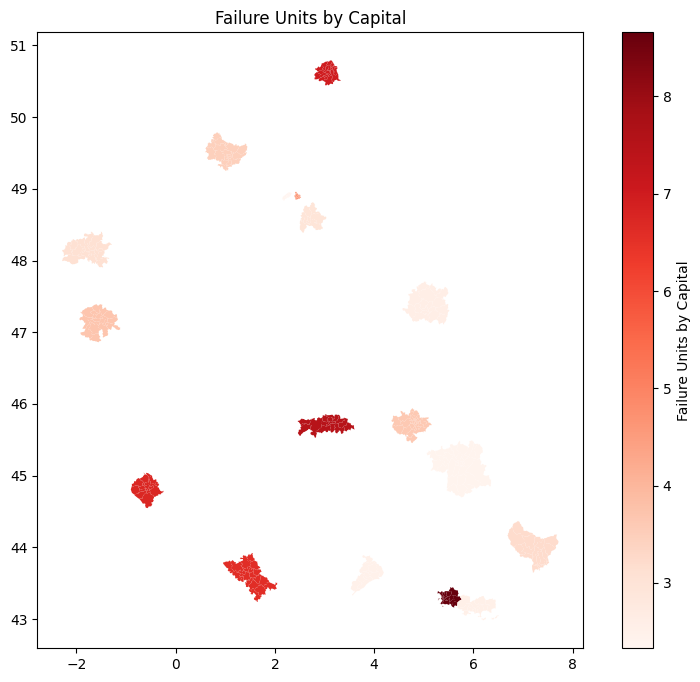

In [50]:
geo_failure_data2.plot(column='FailureUnit', cmap='Reds', legend=True, 
                      legend_kwds={'label': "Failure Units by Capital"},
                      figsize=(10, 8))
plt.title("Failure Units by Capital")
plt.show()

In [46]:
# Create a base map
m = folium.Map(location=[46.603354, 1.888334], zoom_start=6)  # Coordinates of France

In [51]:
# Add choropleth layer
folium.Choropleth(
    geo_data=geo_failure_data2, 
    name='choropleth',
    data=geo_failure_data2,
    columns=['NAME_3', 'FailureUnit'],
    key_on='feature.properties.NAME_3', 
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Failure Units'
).add_to(m)

# Display the map
m.save("failure_units_map.html")

In [52]:
m